We are going to work in the mark of Senegal

In [1]:
senegal_coordinates = (-17.535, 12.332, -11.345, 16.691)

In [2]:
import rasterio
from rasterio.plot import show, show_hist
from matplotlib import pyplot
import numpy as np

We achieve all the data, i.e., the landcover, the DSMP data, the population, the drought of the soil, 
the forest fragmentation, the NDVI, the volume of precipitation, the net primary production, the solar radiation and the temperature

In [3]:
#Get the data of landcover
from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'landcover_'+str(i),'landcover:LandCoverType')

In [4]:
#Get the data of volume of precipitation
from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'precipitation/volume_'+str(i),'earth:RainfallVolume')

In [5]:
#Get the data of forest fragmentation
from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'forest_fr/fragmentation_'+str(i),'ecology:ForestFragmentation')

In [6]:
#Get the data of the atmospheric temperature

for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'temperature/atmosphere_'+str(i),'earth:AtmosphericTemperature')

In [7]:
#Get the data of the net primary production

for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'primary_production/net_'+str(i),'ecology:NetPrimaryProduction')

importamos los inputs, el primero será NDVI(normalized difference vegetation index)

In [9]:
#Get the data of the NDVI

from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'NDVI/NDVI_'+str(i),'ecology:NormalizedDifferenceVegetationIndex')

In [10]:
#Get the data of the drought severity

#from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'drought/drought_severity'+str(i),'soil:DroughtSeverity')

In [11]:
#Get the data of the elevation
#from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'elevation','geography:Elevation')

In [12]:
#Get the data of the solar radiation
#from Connect_Klab import main as connect_klab
for i in range(1992,2011):
    connect_klab(senegal_coordinates[0],senegal_coordinates[1],senegal_coordinates[2],senegal_coordinates[3],i, 'solar_radiation/radiation'+str(i),'earth:SolarRadiation')

save the images in lists

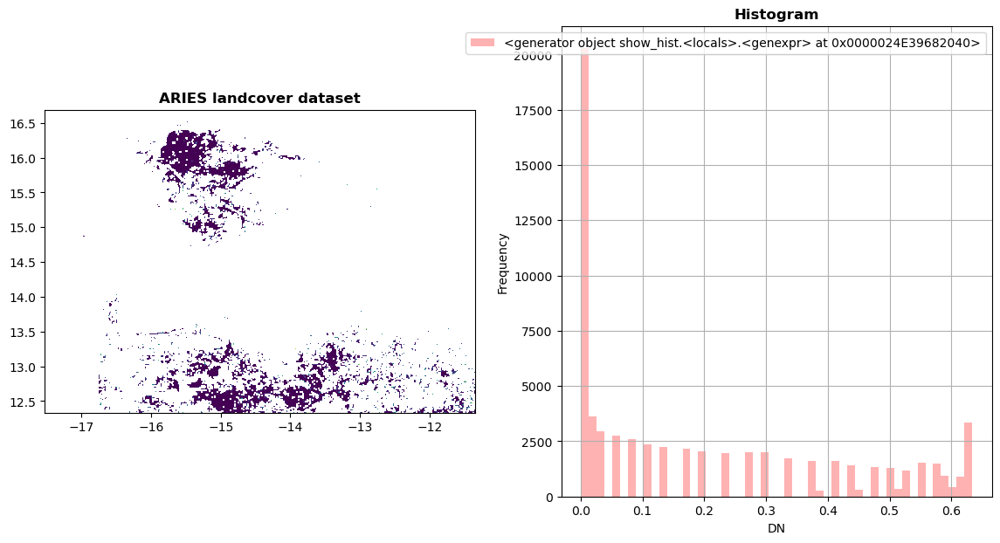

In [13]:
# Show image land cover
with rasterio.open("forest_fr/fragmentation_2010.tif") as src:
    fig, (axrgb, axhist) = pyplot.subplots(1, 2, figsize=(14,7))
    show(src, with_bounds=True, ax=axrgb, title='ARIES landcover dataset')
    show_hist(src, bins=50, lw=0.0, stacked=False, alpha=0.3, histtype='stepfilled', title="Histogram", ax=axhist)

    pyplot.show()

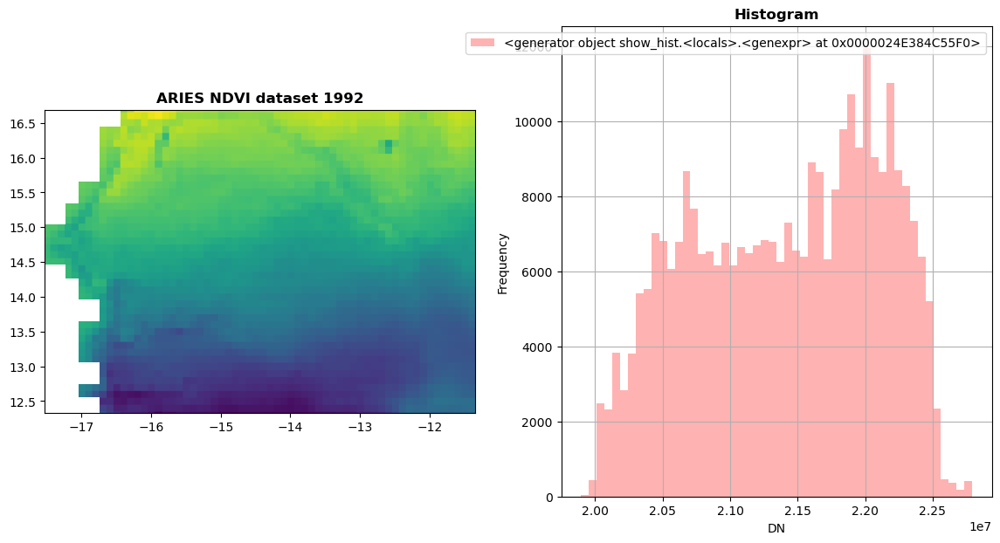

In [14]:
# Show image NDVI
with rasterio.open("solar_radiation/radiation2000.tif") as src:
    fig, (axrgb, axhist) = pyplot.subplots(1, 2, figsize=(14,7))
    show(src, with_bounds=True, ax=axrgb, title='ARIES NDVI dataset 1992')
    show_hist(src, bins=50, lw=0.0, stacked=False, alpha=0.3, histtype='stepfilled', title="Histogram", ax=axhist)

    pyplot.show()

Once we have the data, we charge it in lists

Starting with the Landcover

In [3]:
print("start connecting")
modis_stack = []
years=list(range(1992,2011))
for i in years:
        with rasterio.open(f'landcover/landcover_{i}.tif') as src:
            modis_stack.append(src.read())
       # length()
        print(modis_stack[years.index(i)].shape)

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)


In [4]:
print(len(modis_stack))
print(len(years))

19
19


The goal of the following code is to select only the terrestrial part, by rewriting the number that correspond to the aquatic ones

In [5]:
etiqueta=['EvergreenConiferousForest', 'OpenDeciduousBroadleafForest', 'Shrubland', 'Mangrove', 'OpenDeciduousConiferousForest', 'WaterBody', 'BareArea', 'ClosedDecidousBroadleafForest', 'ClosedDeciduousConiferousForest', 'BeachDuneAndSand', 'Grassland', 'OpenSavanna', 'DeciduousBroadleafforest', 'sparseShrubCover', 'artificialSurface', 'OpenEvergreenConiferousForest', 'SparseTreeCover', 'NonIrregatedArableLandHerbaceous', 'closedEvergreenConiferousforest', 'NonIrrigatedArableLand', 'ClosedSavanna', 'AgriculturalLandWithNaturalVegetation', 'evergreeenBroadleadForest', 'PermanentlyIrrigatedArableLand', 'DeciduousConferousForest', 'MixedForest', 'ComplexCultivationPatternedLand', 'InlandSwamp', 'GlacierPerpetualSnow', 'evergreenShrubland', 'LichenMoss', 'DeciduousShrubland', 'BareRock', 'SparseVegetation', 'SparseHerbaceousCover', 'PermanentCropland', 'Wetland']

etiqueta.index("WaterBody")

5

In [6]:
for a in range(len(years)):
    for i in range(483):
        for j in range(689):
            if j<200 and modis_stack[a][0,i,j]==5:
                modis_stack[a][0,i,j]=-30
        

We change the landcover label into five different labels: buit-up, cropland, Forest, Grassland, Waterbodies

In [7]:
from utilities import change_label
modis_stack=change_label(modis_stack)

37


We check if the change of the aquatic parts is still there

In [8]:
for a in range(len(years)):
    for i in range(483):
        for j in range(689):
            if modis_stack[a][0,i,j]==-30:
                print("It stills here")

It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills here
It stills 

task: charge the pixels of the data that it is not landcover

In [9]:
#Charge the NDVI

print("start connecting")
modis_stack_NDVI = []
for j in years:
    with rasterio.open(f'NDVI/NDVI_{j}.tif') as src:
            modis_stack_NDVI.append(src.read())
    print(modis_stack_NDVI[years.index(j)].shape)

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)


In [10]:
#Charge the precipitation volume

print("start connecting")
modis_stack_precipitation = []
for j in years:
     with rasterio.open(f'precipitation/volume_{j}.tif') as src:
            modis_stack_precipitation.append(src.read())
       # length()
     print(modis_stack_precipitation[years.index(j)].shape)
print(len(modis_stack_precipitation))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


In [11]:
#Charge the temperature of the atmosphere

print("start connecting")
modis_stack_temperature = []
for j in years:
     with rasterio.open(f'temperature/atmosphere_{j}.tif') as src:
            modis_stack_temperature.append(src.read())
       # length()
     print(modis_stack_temperature[years.index(j)].shape)
print(len(modis_stack_temperature))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


In [12]:
#Charge the drought severity of the soil

print("start connecting")
modis_stack_drought = []
for j in years:
     with rasterio.open(f'drought/drought_severity{j}.tif') as src:
            modis_stack_drought.append(src.read())
       # length()
     print(modis_stack_drought[years.index(j)].shape)
print(len(modis_stack_drought))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


The elevation doesn't change in 20 years

In [13]:
#Charge the elevation

print("start connecting")
modis_stack_elevation = []
j=0
with rasterio.open(f'elevation.tif') as src:
            modis_stack_elevation=src.read()
       # length()
print(modis_stack_elevation.shape)

start connecting
(1, 483, 689)


In [14]:
#Charge the solar radiation

print("start connecting")
modis_stack_radiation = []
for j in years:
     with rasterio.open(f'solar_radiation/radiation{j}.tif') as src:
            modis_stack_radiation.append(src.read())
       # length()
     print(modis_stack_radiation[years.index(j)].shape)
print(len(modis_stack_radiation))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


In [15]:
#Charge the net primary production

print("start connecting")
modis_stack_production = []
for j in years:
     with rasterio.open(f'primary_production/net_{j}.tif') as src:
            modis_stack_production.append(src.read())
       # length()
     print(modis_stack_production[years.index(j)].shape)
print(len(modis_stack_production))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


In [16]:
#Charge the DSMP

from rasterio.windows import from_bounds

modis_stack_DSMP=[]

print("start connecting")
# Route to the TIF mundial file
for i in years:
    ruta_archivo_tif = 'datos_DSMP/DSMP_'+str(i)+'.tif'

# Open the TIF file
    with rasterio.open(ruta_archivo_tif) as src:
    # Create a window based on the Senegal coordinates
        ventana_recorte = from_bounds(*senegal_coordinates, src.transform)

    # Read the region of interes
        modis_stack_DSMP.append(src.read(window=ventana_recorte))

    print(modis_stack_DSMP[years.index(i)].shape)
print(len(modis_stack_DSMP))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


In [17]:
#Get the population data of 2010, in the same way that with the DSMP data

modis_stack_population=[]

print("start connecting")


ruta_archivo_tif = 'asentamientos/nuevas_coordenadas_escala.tif'

with rasterio.open(ruta_archivo_tif) as src:
    
    ventana_recorte = from_bounds(*senegal_coordinates, src.transform)

    
    modis_stack_population.append(src.read(window=ventana_recorte))

print(modis_stack_population[0].shape)
print(len(modis_stack_population))

start connecting
(1, 483, 689)
1


In [18]:
#Get the population data of 2010, in the same way that with the DSMP data

print("start connecting")

ruta_archivo_tif = 'asentamientos/nuevas_coordenadas_escala_1995.tif'

with rasterio.open(ruta_archivo_tif) as src:
    ventana_recorte = from_bounds(*senegal_coordinates, src.transform)

    modis_stack_population.append(src.read(window=ventana_recorte))

print(modis_stack_population[1].shape)
print(len(modis_stack_population))

start connecting
(1, 483, 689)
2


In [19]:
#Get the forest fragmentation data

print("start connecting")
modis_stack_fragmentation = []
for j in years:
     with rasterio.open(f'forest_fr/fragmentation_{j}.tif') as src:
            modis_stack_fragmentation.append(src.read())
       # length()
     print(modis_stack_fragmentation[years.index(j)].shape)
print(len(modis_stack_fragmentation))

start connecting
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
(1, 483, 689)
19


We create a list with the names of the different land cover classes

In [20]:
etiqueta2=['forest', 'cropland', 'grassland', 'waterbody', 'built_up']

there are some pixels that doesn't have changed, it correspond mostly to waterbodies, and that makes sense
we can see it as follows:

In [21]:
total_area=483*689

In [36]:
agua_con_NDVI=0
tierra_sin_NDVI=0
total_NDVI=0
total_agua=0
for i in range(483):
    for j in range(689):
        if modis_stack_NDVI[0][0,i,j]>0 or modis_stack_NDVI[0][0,i,j]<1:
            if modis_stack[years.index(2003)][0,i,j]==4:
                agua_con_NDVI+=1
                total_agua+=1
        else:
            if modis_stack[years.index(2003)][0,i,j]!=4:
                tierra_sin_NDVI+=1
            else:
                total_agua+=1
print("Hay un "+str(agua_con_NDVI*100/total_agua)+"%" +" de agua con NDVI")
print("Hay un "+str(tierra_sin_NDVI*100/(total_area-total_NDVI))+"%"+ " de pixel sin NDVI en tierra")

Hay un 89.46203844558153% de agua con NDVI
Hay un 13.295591474426585% de pixel sin NDVI en tierra


we save in a vector the pixels that doesn't have changed from one year to the next one

In [22]:
difference=[]
change_map=[]
for a in range(len(years)-1):
    difference.append(np.abs(modis_stack[a] - modis_stack[a+1]))
    change_map.append(np.where(difference[a] > 0, 1, 0))
print(change_map[0].shape)

(1, 483, 689)


we save in a vector the pixels that doesn't have changed from 1990 to 2010

In [23]:
change_total=np.zeros([483,689], dtype=int)
for i in range(483):
    for j in range(689):
        for a in range(len(years)-1):#len(years) because there have been 1 less change than the number of years
            if change_map[a][0,i,j]!=0:
                change_total[i,j]+=1#it's greater than 1 if there is change, it's 0 if there is not change
            

create a list with the positions where it doesn't have changed


In [32]:
change_positions=[]
a=0
for i in range(483):
    for j in range(689):
        if change_total[i,j]==0 and modis_stack[0][0,i,j]!=-30: 
            change_positions.append([i,j])
            #print(change_positions[a])

we measures how many points doesn't have changed

In [33]:
print(len(change_positions))

278422


measures how many points are of each area in year 2003 (we have selected this year because itt is in the middle between 1992 and 2010)

In [34]:
total_terrestrial=0
total_landcover=np.zeros(6, dtype=int)
for i in range(483):
    for j in range(689):
        if modis_stack[years.index(2003)][0,i,j]!=-30:
            total_landcover[modis_stack[years.index(2003)][0,i,j]]+=1
            total_terrestrial+=1
            

Porcentaje of each area

In [35]:
porcentaje_landcover=[x / (total_terrestrial) * 100 for x in total_landcover]

In [27]:
print(total_landcover)
print(porcentaje_landcover)

[     0  44318  88523 146220   7231    568]
[0.0, 15.449348114062609, 30.859304190197307, 50.972599874503246, 2.520741825280625, 0.19800599595621557]


we measure how much area there is where it doesn't have changed

In [28]:
total_terrestrial_equal=0
total_landcover_equal=np.zeros(6, dtype=int)
for i in change_positions:#if the point doesn't have changed
    #print(modis_stack[years.index(2003)][0,i,j])
    total_landcover_equal[modis_stack[years.index(2003)][0,i[0],i[1]]]+=1
    total_terrestrial_equal+=1
porcentaje_landcover_equal=[x / total_terrestrial_equal * 100 for x in total_landcover_equal]
print(total_landcover_equal)
print(porcentaje_landcover_equal)

[     0  41636  85206 144116   7042    422]
[0.0, 14.954278038373403, 30.60318509313201, 51.76171423235233, 2.5292541537665842, 0.15156848237567433]


In [37]:
etiqueta2=['forest', 'cropland', 'grassland', 'waterbody', 'built_up']
for i in range(5):
    print(etiqueta2[i]+"The percentage of the selected is:" +str(porcentaje_landcover_equal[i+1])+" the percentage without processing is "+str(porcentaje_landcover[i+1]))

forestThe percentage of the selected is:14.954278038373403 the percentage without processing is 15.449348114062609
croplandThe percentage of the selected is:30.60318509313201 the percentage without processing is 30.859304190197307
grasslandThe percentage of the selected is:51.76171423235233 the percentage without processing is 50.972599874503246
waterbodyThe percentage of the selected is:2.5292541537665842 the percentage without processing is 2.520741825280625
built_upThe percentage of the selected is:0.15156848237567433 the percentage without processing is 0.19800599595621557


create a matrix with the inputs and the outputs of each pixel

In [38]:
import math

We create a new array for each variable where it appears, in each position, the mean of all the values that are in the same position

In [39]:
#Mean of NDVI

NDVI = np.array(modis_stack_NDVI)

#  Calculate the media in the first axis
media_NDVI = np.mean(NDVI, axis=0)

print(media_NDVI.shape)

(1, 483, 689)


In [40]:
#Mean of the drought of the soil

drought = np.array(modis_stack_drought)

media_drought = np.mean(drought, axis=0)

print(media_drought.shape)

(1, 483, 689)


In [41]:
#Mean of the luminosity (DSMP)

DSMP = np.array(modis_stack_DSMP)

media_DSMP = np.mean(DSMP, axis=0)

print(media_DSMP.shape)

(1, 483, 689)


In [43]:
#Mean of the radiation

Rad = np.array(modis_stack_radiation[3:])#It starts in 3, because the all the other data has nan in all the positions

# Calculamos la media a lo largo del primer eje (axis=0)
media_rad = np.mean(Rad, axis=0)

print(media_rad.shape)


(1, 483, 689)


In [44]:
#Mean of the precipitation volume

prep = np.array(modis_stack_precipitation[3:])#We start in 3 for the same reason as in radiation

media_prep = np.mean(prep, axis=0)

print(media_prep.shape)

(1, 483, 689)


In [45]:
#Mean of the atmospheric temperature

temp = np.array(modis_stack_temperature)

# Calculamos la media a lo largo del primer eje (axis=0)
media_temp = np.mean(temp, axis=0)

print(media_temp.shape)

(1, 483, 689)


In [46]:
#Mean of the net primary production

prod = np.array(modis_stack_production)

media_prod = np.mean(prod, axis=0)

print(media_prod.shape)

(1, 483, 689)


In [47]:
#Mean of the fragmentation

frag = np.array(modis_stack_fragmentation)

media_frag = np.mean(frag, axis=0)

print(media_frag.shape)

(1, 483, 689)


In [48]:
information=[["NDVI","Drought","Elevation","DSMP","Population","Radiation","Precipitation","Temperature","Production","Fragmentation","Position","Landcover"]]
j=0
for i in change_positions:
    r=[]
    j+=1
    if math.isnan(float(media_temp[0,i[0],i[1]]))==False and math.isnan(float(media_rad[0,i[0],i[1]]))==False:
        if math.isnan(float(media_NDVI[0,i[0],i[1]]))==False:
            r.append(media_NDVI[0,i[0],i[1]])
        if math.isnan(float(media_NDVI[0,i[0],i[1]]))==True:
            r.append(0)
        r.append(media_drought[0,i[0],i[1]])
        r.append(modis_stack_elevation[0,i[0],i[1]])
        r.append(media_DSMP[0,i[0],i[1]])
        r.append(modis_stack_population[0][0,i[0],i[1]])
        if math.isnan(float(media_rad[0,i[0],i[1]]))==False:
            r.append(media_rad[0,i[0],i[1]])
        if math.isnan(float(media_rad[0,i[0],i[1]]))==True:
            r.append(0)
        if math.isnan(float(media_prep[0,i[0],i[1]]))==False:
            r.append(media_prep[0,i[0],i[1]])
        if math.isnan(float(media_prep[0,i[0],i[1]]))==True:
            r.append(0)
        if math.isnan(float(media_temp[0,i[0],i[1]]))==False:
            r.append(media_temp[0,i[0],i[1]])
        if math.isnan(float(media_temp[0,i[0],i[1]]))==True:
            r.append(0)
        if math.isnan(float(media_prod[0,i[0],i[1]]))==False:
            r.append(media_prod[0,i[0],i[1]])
        if math.isnan(float(media_prod[0,i[0],i[1]]))==True:
            r.append(0)
        if math.isnan(float(media_frag[0,i[0],i[1]]))==False:
            r.append(media_frag[0,i[0],i[1]])
        if math.isnan(float(media_frag[0,i[0],i[1]]))==True:
            r.append(-30)
        r.append(i)
        r.append(modis_stack[years.index(2003)][0,i[0],i[1]])
        information.append(r)



We save the information matrix into a csv file

In [49]:
import csv

In [50]:
with open('information.csv', 'w', newline='') as file:
    # Step 4: Using csv.writer to write the list to the CSV file
    writer = csv.writer(file)
    writer.writerows(information) # Use writerows for nested list

between the pixels in train you see how many are of each landcover

we start the random forest algorithm

In [51]:
years.index(1992)

0

We select the 80% of the variables that have more ANOVA

In [52]:
import pandas as pd
df = pd.read_csv("information.csv")
feature_names = ['NDVI', 'Drought', 'Elevation', 'DSMP', 'Population', 'Radiation', 'Precipitation','Temperature', 'Production','Fragmentation']
#feature_names = ['NDVI', 'Drought', 'DSMP', 'Population', 'Radiation', 'Precipitation','Temperature', 'Production','Fragmentation']
label = "Landcover"
X = df[feature_names]
y = df[label]


In [53]:
print(y)

0         3
1         3
2         3
3         3
4         3
         ..
278354    1
278355    1
278356    1
278357    1
278358    1
Name: Landcover, Length: 278359, dtype: int64


In [62]:
from sklearn.feature_selection import SelectPercentile, f_classif
print(X.shape)
f_statistic, p_values = f_classif(X, y)
X_new = SelectPercentile(f_classif, percentile=80).fit_transform(X, y)
#print(X_new.shape)
#print(X_new[0])
#feature_names = ['NDVI', 'Drought', 'Elevation', 'DSMP', 'Population', 'Radiation', 'Precipitation','Temperature', 'Production','Fragmentation']

for i in range(len(f_statistic)):
    print(feature_names[i]+" tiene un f-statistic de "+str(f_statistic[i]))
print(f_statistic)
print(p_values)


(278359, 10)
NDVI tiene un f-statistic de 43579.88546732865
Drought tiene un f-statistic de 7649.464729050968
Elevation tiene un f-statistic de 6633.539293644274
DSMP tiene un f-statistic de 28274.33875849342
Population tiene un f-statistic de 42568.23576053334
Radiation tiene un f-statistic de 39328.871765685275
Precipitation tiene un f-statistic de 46517.38149289146
Temperature tiene un f-statistic de 26334.595178076255
Production tiene un f-statistic de 19953.755721727495
Fragmentation tiene un f-statistic de 33474.06814567784
[43579.88546733  7649.46472905  6633.53929364 28274.33875849
 42568.23576053 39328.87176569 46517.38149289 26334.59517808
 19953.75572173 33474.06814568]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


This variables are NDVI, drought, DSMP, population, radiation, precipitation, temperature, production, fragmentation

In [63]:
print(X_new[0])

[ 0.0000000e+00  1.2309525e+00  0.0000000e+00  2.2019304e+07
  3.8132610e-01  2.4180431e+01  0.0000000e+00 -3.0000000e+01]


In [64]:
print(df)

            NDVI   Drought  Elevation       DSMP  Population   Radiation  \
0       0.000000  0.052632        4.0   1.230952           0  22019304.0   
1       0.000000  0.052632        6.0   1.752026           0  22019304.0   
2       0.000000  0.052632        6.0   1.482358           0  22019304.0   
3       0.163789  0.052632        1.0   1.039289           0  22019304.0   
4       0.147579  0.052632       -2.0   1.395723           0  22229072.0   
...          ...       ...        ...        ...         ...         ...   
278354  0.548000  0.000000      165.0   9.299397           0  20867802.0   
278355  0.525684  0.000000      274.0  10.063164           1  20867802.0   
278356  0.522105  0.000000      423.0  10.117022           0  20867802.0   
278357  0.533684  0.000000      528.0  11.606498           0  20867802.0   
278358  0.543368  0.000000      531.0  12.887153           0  20897374.0   

        Precipitation  Temperature  Production  Fragmentation    Position  \
0         

NDVI tiene un f-statistic de 43579.88546732865 V
Drought tiene un f-statistic de 7649.464729050968 V
Elevation tiene un f-statistic de 6633.539293644274
DSMP tiene un f-statistic de 28274.33875849342 V
Population tiene un f-statistic de 42568.23576053334 V
Radiation tiene un f-statistic de 39328.871765685275 V
Precipitation tiene un f-statistic de 46517.38149289146 V
Temperature tiene un f-statistic de 26334.595178076255 V
Production tiene un f-statistic de 5317.478156577808
Fragmentation tiene un f-statistic de 33474.06814567784 V

We create the random forest only with this variables

In [57]:
from sklearn import ensemble

n_trees=500
rf = ensemble.RandomForestClassifier(n_trees)

84.8379

In [71]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_new, y, test_size=0.2, random_state=42)
n_trees = 500
rf = ensemble.RandomForestClassifier(n_trees).fit(X_train, y_train)

We test our algorithm using the cross_validation method

In [59]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

#We shuffle the data before the validation because the rows with the same landcover are very close one to each other
kf=KFold(n_splits=5, random_state=None, shuffle=True)
scores_shuffle = cross_val_score(rf, X_new, y, cv=kf)

We show the results of the cross validation

In [60]:
print(scores_shuffle)
print(np.mean(scores_shuffle))

[0.83912919 0.83869809 0.8429372  0.84151818 0.84016813]
0.8404901572357042


We show how are distributed the K-folds, with shuffle and without it

<Axes: title={'center': 'KFold with shuffle'}, xlabel='Sample index', ylabel='CV iteration'>

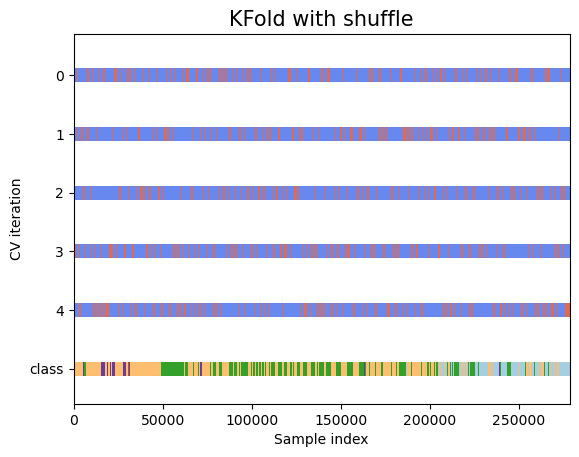

In [61]:
import matplotlib.pyplot as plt

cmap_data = plt.cm.Paired
cmap_cv = plt.cm.coolwarm

n=len(y)
X_nueva=X[:n]
y_nueva=y[:n]


def plot_cv_indices(cv, X, y, ax, n_splits, name, lw=10):
    """Create a sample plot for indices of a cross-validation object."""

    # Generate the training/testing visualizations for each CV split
    for ii, (tr, tt) in enumerate(cv.split(X=X, y=y)):
        # Fill in indices with the training/test groups
        indices = np.array([np.nan] * len(X))
        indices[tt] = 1
        indices[tr] = 0

        # Visualize the results
        ax.scatter(
            range(len(indices)),
            [ii + 0.5] * len(indices),
            c=indices,
            marker="_",
            lw=lw,
            cmap=cmap_cv,
            vmin=-0.2,
            vmax=1.2,
        )

    # Plot the data classes and groups at the end
    ax.scatter(
        range(len(X)), [ii + 1.5] * len(X), c=y, marker="_", lw=lw, cmap=cmap_data
    )

    

    # Formatting
    yticklabels = list(range(n_splits)) + ["class"]
    ax.set(
        yticks=np.arange(n_splits + 1) + 0.5,
        yticklabels=yticklabels,
        xlabel="Sample index",
        ylabel="CV iteration",
        ylim=[n_splits + 1.1, -0.2],
        xlim=[0, n],
    )
    ax.set_title(name, fontsize=15)
    return ax

fig, ax = plt.subplots()
cv = kf
n_splits=5
plot_cv_indices(cv, X_nueva, y_nueva, ax, n_splits, "KFold with shuffle")

<Axes: title={'center': 'KFold without shuffle'}, xlabel='Sample index', ylabel='CV iteration'>

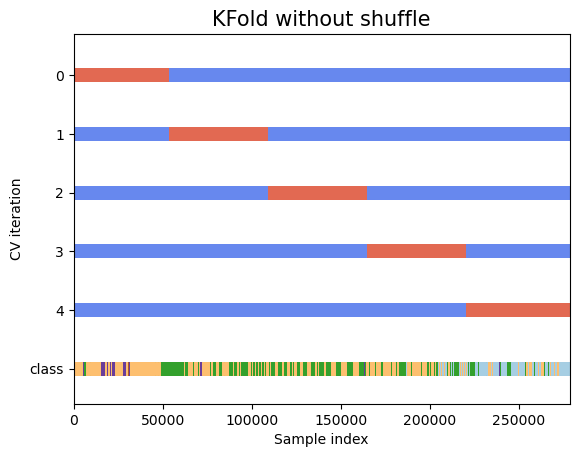

In [65]:
fig, ax = plt.subplots()
cv=KFold(n_splits)
plot_cv_indices(cv, X_nueva, y_nueva, ax, n_splits, "KFold without shuffle")

We predict the land cover classes and create the confusion matrix

In [66]:
from sklearn.model_selection import cross_val_predict
y_pred=cross_val_predict(rf, X, y, cv=kf)

In [67]:
etiqueta2=['forest', 'cropland', 'grassland', 'waterbody', 'built_up']

forest_pred=[0 for k in range(5)]
crop_pred=[0 for k in range(5)]
grass_pred=[0 for k in range(5)]
water_pred=[0 for k in range(5)]
built_pred=[0 for k in range(5)]

for i in range(0, 278359):
    for j in range(5):        
        if y[i]==j+1:
            if y_pred[i]==1:  
                forest_pred[j]+=1
            elif y_pred[i]==2:
                crop_pred[j]+=1
            elif y_pred[i]==3:
                grass_pred[j]+=1
            elif y_pred[i]==4:
                water_pred[j]+=1
            elif y_pred[i]==5:
                built_pred[j]+=1
print("Matriz de confusion")

print(forest_pred)
print(crop_pred)
print(grass_pred)
print(water_pred)
print(built_pred)

#416096

Matriz de confusion
[33996, 2343, 4776, 157, 0]
[2303, 69125, 9585, 677, 92]
[5210, 13011, 128252, 1338, 34]
[99, 649, 1493, 4861, 13]
[1, 46, 9, 6, 283]


We analyse the land cover changes

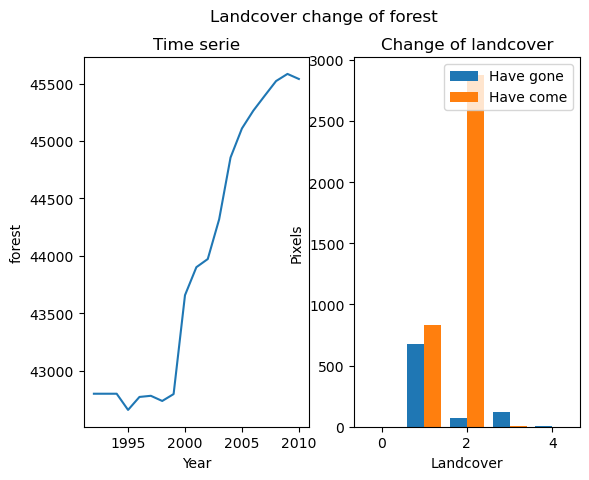

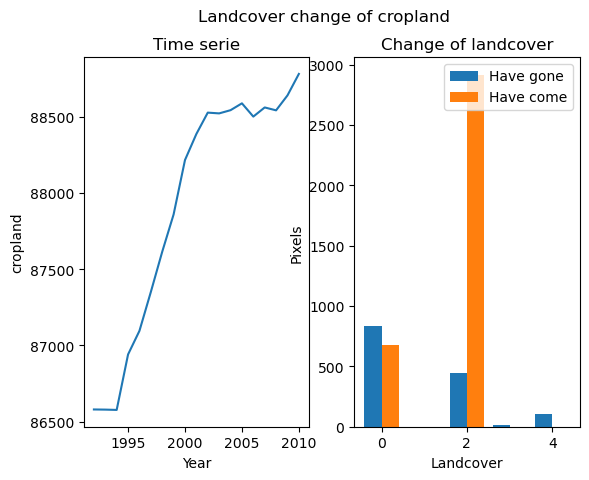

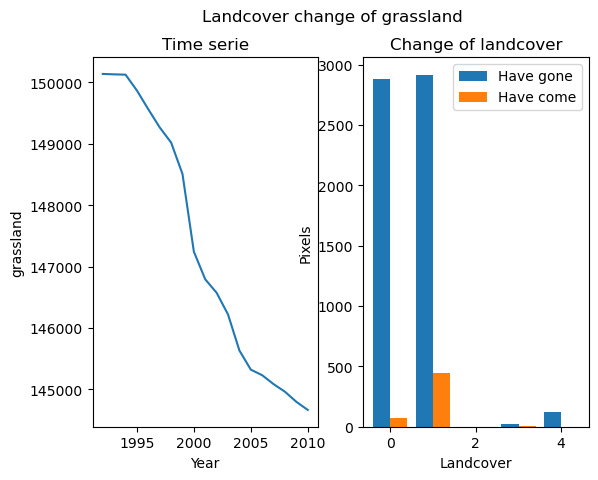

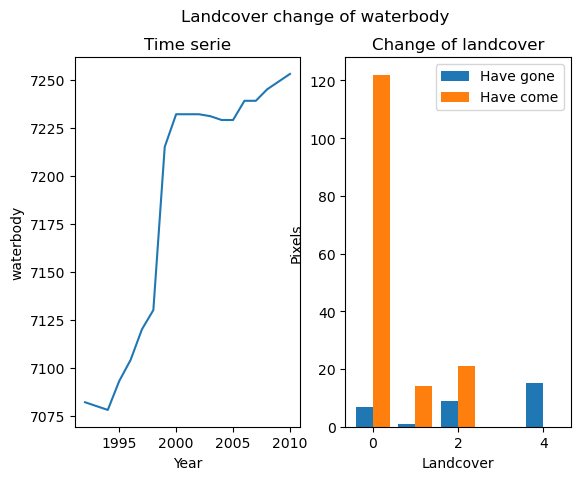

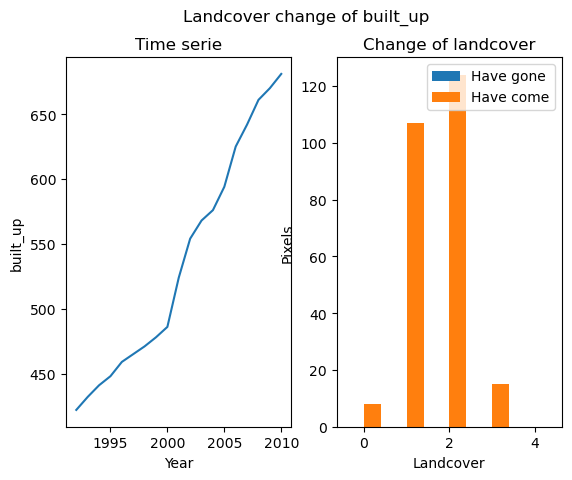

In the position (435,112), it has changed from forest to waterbody
In the position (435,113), it has changed from forest to waterbody
In the position (454,220), it has changed from forest to waterbody
In the position (448,225), it has changed from forest to waterbody
In the position (453,200), it has changed from forest to waterbody
In the position (454,200), it has changed from forest to waterbody
In the position (454,202), it has changed from forest to waterbody
In the position (454,205), it has changed from forest to waterbody
In the position (455,207), it has changed from forest to waterbody
In the position (455,208), it has changed from forest to waterbody
In the position (457,217), it has changed from forest to waterbody
In the position (396,438), it has changed from cropland to waterbody
In the position (431,226), it has changed from forest to waterbody
In the position (443,224), it has changed from forest to waterbody
In the position (453,204), it has changed from forest to wat

In [68]:
from illogical_changes import main as illogical
ilpo=illogical(modis_stack, change_map, years, etiqueta2)

In [69]:
print(len(ilpo))#there are 164 illogical transformations

164


We create a new matrix with the inputs that correspond to the illogical transitions

In [72]:
X_illo=[["NDVI","DSMP","Population","Radiation","Precipitation","Temperature","Production","Fragmentation"]]
for i in range(len(ilpo)):
    r=[]
    if math.isnan(float(modis_stack_NDVI[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
        r.append(modis_stack_NDVI[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_NDVI[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==True:
        r.append(0)
    r.append(modis_stack_DSMP[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    r.append(modis_stack_population[0][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_radiation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
        r.append(modis_stack_radiation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_radiation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==True:
        r.append(0)
    if math.isnan(float(modis_stack_precipitation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
        r.append(modis_stack_precipitation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_precipitation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==True:
        r.append(0)
    if math.isnan(float(modis_stack_temperature[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
        r.append(modis_stack_temperature[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_temperature[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==True:
        r.append(0)
    if math.isnan(float(modis_stack_production[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
        r.append(modis_stack_production[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_production[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==True:
        r.append(0)
    if math.isnan(float(modis_stack_fragmentation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
        r.append(modis_stack_fragmentation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]])
    if math.isnan(float(modis_stack_fragmentation[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==True:
        r.append(0)
    X_illo.append(r)

nombres_columnas = X_illo[0]

X_illo = pd.DataFrame(X_illo[1:], columns=nombres_columnas)
print(X_illo)


Y=rf.predict(X_illo)


      NDVI      DSMP  Population   Radiation  Precipitation  Temperature  \
0    0.256  0.000000           0         0.0       0.000000    26.341303   
1    0.300  0.063929           6         0.0       0.000000    26.341303   
2    0.328  0.000000         217         0.0       0.000000    26.833979   
3    0.380  5.939346          98  20292636.0       3.133699    27.395594   
4    0.276  0.980780           0  20144128.0       3.022877    27.355494   
..     ...       ...         ...         ...            ...          ...   
159  0.000  0.494368           0  21574182.0       0.875589    30.391108   
160  0.000  0.068808           0  21574182.0       0.875589    30.391108   
161  0.000  4.126011           0  21574182.0       0.875589    30.391108   
162  0.000  0.460773           0  21574182.0       0.875589    30.391108   
163  0.340  0.481452           0  19826284.0       3.085726    25.864710   

     Production  Fragmentation  
0         1.334         0.4997  
1         2.012      

c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


We rewrite the values of the landcover, but if it is a illogical position, we change it with the value of Y

In [73]:
num_iltra=0
for i in ilpo:
    if modis_stack[years.index(i[0])][0,i[1],i[2]]!=Y[ilpo.index(i)]:
        num_iltra+=1
        print("De "+str(modis_stack[years.index(i[0])][0,i[1],i[2]])+"ha pasado a "+str(Y[ilpo.index(i)])+"en el año "+str(i[0])+", en el siguiente es "+str(modis_stack[years.index(i[0])+1][0,i[1],i[2]])+"en la posicion ("+str(i[1])+","+str(i[2])+")")
print(num_iltra)
                

De 3ha pasado a 1en el año 1996, en el siguiente es 4en la posicion (396,438)
De 2ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (339,200)
De 2ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (339,201)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (395,438)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (419,400)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (420,397)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (420,398)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (420,402)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (420,403)
De 3ha pasado a 1en el año 1998, en el siguiente es 4en la posicion (421,397)
De 1ha pasado a 2en el año 1998, en el siguiente es 4en la posicion (432,224)
De 1ha pasado a 2en el año 1998, en el siguiente es 4en la posicion (437,222)
De 2ha pasado a 1en el año 1998, en el siguiente es 4en la posic

There has been 102 changes

In [74]:
modis_stack_final=modis_stack
for i in ilpo:
    modis_stack_final[years.index(i[0])][0,i[1],i[2]]=Y[ilpo.index(i)]

We see if we still containing illogical changes

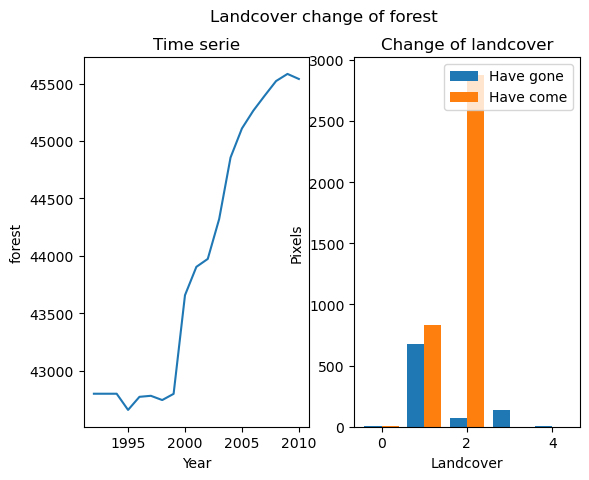

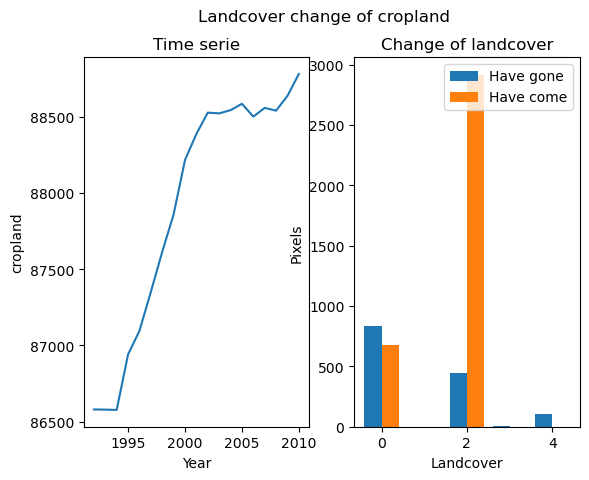

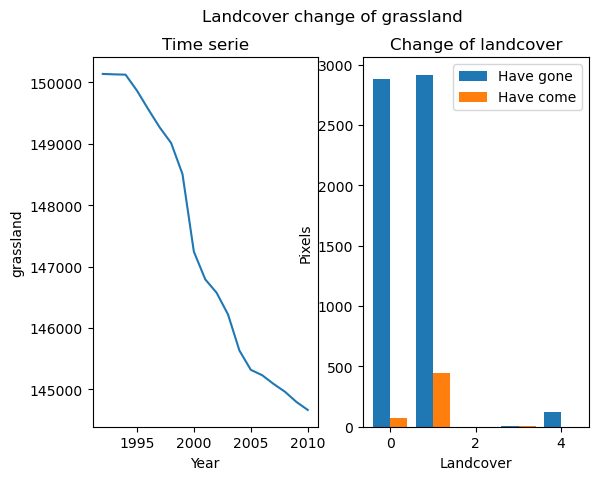

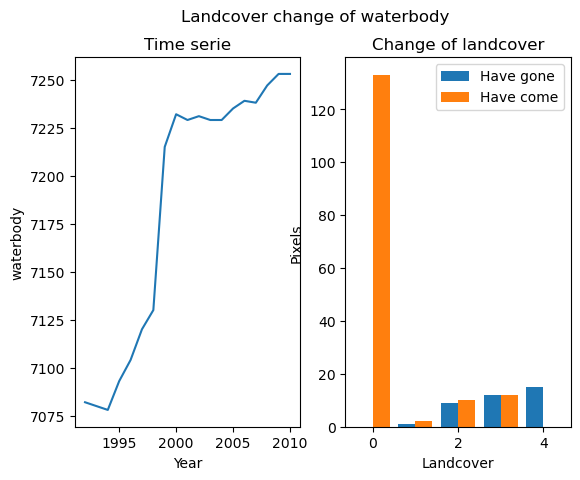

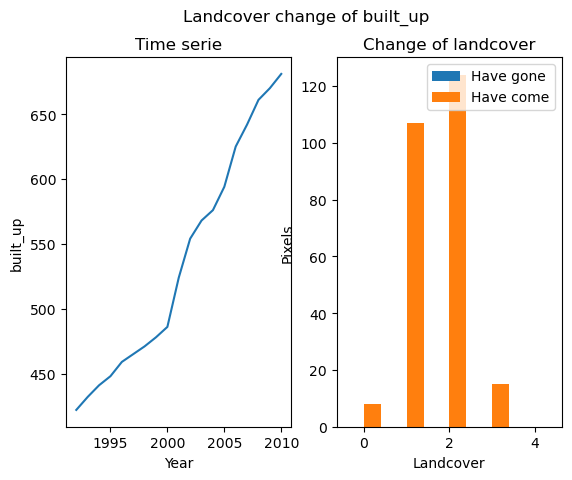

In the position (435,112), it has changed from forest to waterbody
In the position (435,113), it has changed from forest to waterbody
In the position (454,220), it has changed from forest to waterbody
In the position (448,225), it has changed from forest to waterbody
In the position (453,200), it has changed from forest to waterbody
In the position (454,200), it has changed from forest to waterbody
In the position (454,202), it has changed from forest to waterbody
In the position (454,205), it has changed from forest to waterbody
In the position (455,207), it has changed from forest to waterbody
In the position (455,208), it has changed from forest to waterbody
In the position (457,217), it has changed from forest to waterbody
In the position (396,438), it has changed from forest to waterbody
In the position (431,226), it has changed from forest to waterbody
In the position (443,224), it has changed from forest to waterbody
In the position (453,204), it has changed from forest to water

In [75]:
from illogical_changes import main as illogical
ilpo=illogical(modis_stack_final, change_map, years, etiqueta2)

We check what has happened in the new illogical transitions

In [76]:
num_iltra=0
for i in ilpo:
    if modis_stack[years.index(i[0])][0,i[1],i[2]]!=Y[ilpo.index(i)]:
        num_iltra+=1
        print("De "+str(modis_stack[years.index(i[0])][0,i[1],i[2]])+"ha pasado a "+str(Y[ilpo.index(i)])+"en el año "+str(i[0])+", en el siguiente es "+str(modis_stack[years.index(i[0])+1][0,i[1],i[2]])+"en la posicion ("+str(i[1])+","+str(i[2])+")")
print(num_iltra)

De 4ha pasado a 1en el año 2000, en el siguiente es 1en la posicion (319,94)
De 4ha pasado a 1en el año 2000, en el siguiente es 1en la posicion (351,218)
De 4ha pasado a 1en el año 2000, en el siguiente es 1en la posicion (429,86)
De 4ha pasado a 1en el año 2001, en el siguiente es 1en la posicion (360,214)
De 4ha pasado a 1en el año 2002, en el siguiente es 1en la posicion (379,184)
De 4ha pasado a 1en el año 2002, en el siguiente es 1en la posicion (379,185)
De 2ha pasado a 4en el año 2004, en el siguiente es 4en la posicion (54,468)
De 2ha pasado a 4en el año 2004, en el siguiente es 4en la posicion (56,470)
De 3ha pasado a 4en el año 2004, en el siguiente es 4en la posicion (57,469)
De 2ha pasado a 4en el año 2004, en el siguiente es 4en la posicion (57,470)
De 3ha pasado a 4en el año 2004, en el siguiente es 4en la posicion (58,469)
De 3ha pasado a 4en el año 2004, en el siguiente es 4en la posicion (58,470)
De 4ha pasado a 3en el año 2006, en el siguiente es 1en la posicion (412

Super useless, we still containing illogical transformations, before we had 164 illogical transformations and now we have 160

We repeat the algorithm of detecting the illogical transitions and predicting the new classes many times

In [78]:
%load_ext autoreload

In [174]:
%autoreload 2

In [175]:
from cosa import main as ReductionIllogical

modis_stack_final, illogical_positions=ReductionIllogical(rf, years, modis_stack, modis_stack_NDVI, modis_stack_population, modis_stack_radiation, modis_stack_DSMP, modis_stack_precipitation, modis_stack_temperature, modis_stack_production, modis_stack_fragmentation)


aaaaaaaaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


There are157 illogical positions
[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


[1994, 435, 113]aaa
There are157 illogical positions


c:\Users\glode\anaconda3\lib\site-packages\sklearn\base.py:458: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


In [109]:
modis_stack[years.index(1994)]

array([[[-30, -30, -30, ...,   3,   3,   3],
        [-30, -30, -30, ...,   3,   3,   3],
        [-30, -30, -30, ...,   3,   3,   3],
        ...,
        [-30, -30, -30, ...,   1,   1,   1],
        [-30, -30, -30, ...,   1,   3,   3],
        [-30, -30, -30, ...,   1,   1,   1]]])

In [89]:
i=0
ilpo=[[1994,435,112]]
if math.isnan(float(modis_stack_NDVI[years.index(ilpo[i][0])][0,ilpo[i][1],ilpo[i][2]]))==False:
    print("DAS")


DAS


In [ ]:
print(len(illogical_positions))

61


We save in a list the number of illogical transformations of each iteration

In [ ]:
len_ilpo=[]
for i in range(len(illogical_positions)):
    len_ilpo.append(len(illogical_positions[i]))


In [ ]:
len_ilpo

[164,
 160,
 160,
 159,
 159,
 158,
 158,
 155,
 155,
 154,
 154,
 153,
 153,
 142,
 142,
 141,
 141,
 141,
 141,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 140,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138,
 138]

In [ ]:
import matplotlib.pyplot as plt

We represent it in a plot

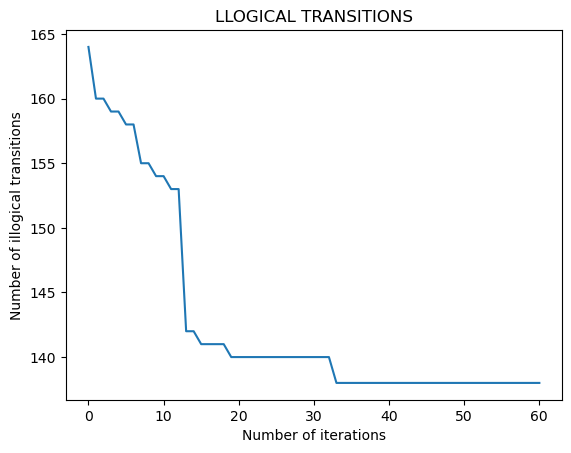

In [ ]:

plt.plot(range(len(len_ilpo)),np.array(len_ilpo, dtype=int))
plt.xlabel("Number of iterations")
plt.ylabel("Number of illogical transitions")
plt.title("LLOGICAL TRANSITIONS")

plt.show()